# Liver Project

Advanced Medical Image Processing

March 2019

#Introduction

A fully automatic technique for segmenting the liver and localizing its unhealthy tissues is essential in many clinical applications, such as pathological diagnosis, surgical planning, and postoperative assessment. However, it is still a very challenging task due to the complex background, fuzzy boundary, and various appearance of both liver and liver lesions.

## Tasks
In this project we will develop automatic algorithms to segment liver and liver lesions in abdominal CT scans. To achieve this goal you'll utilize the power of deep learning algorithms.

The project consists of the following tasks:


1.   Liver segmentation
2.   Lesions segmentation


## Data

The training data set consists of 11 CT scans:

*   'Data' directory contains CT images converted to 'png' format
*   'Segmentation' directory contains segmentation masks:
    >* Pixels with value 127 indicate liver
    >* Pixels with value 255 indicate liver lesion

The data can be downloaded from the following link: [data link](https://drive.google.com/open?id=1lhYdOFymZSC5Gz76Zt4GzcDYc8nWaWJv).

## Evaluation metrics
The following metrics will be used to evaluate the segmentation accuracy:


*   Dice similarity coeffcient (Dice): 

>$Dice = \frac{2\times TP}{2\times TP+FP+FN}$

> TP, FP, and FN denote the number of true positive, false positive, and false negative pixels respectively. Dice computes a normalized overlap value between the produced and ground truth segmentation.

*   Precision (positive predictive rate):

>$Precision = \frac{TP}{TP + FP}$

>Precision expresses the proportion between the true segmented pixels and all pixels the model associates with liver / lesions.

*   Recall (sensitivity):

>$Recall = \frac{TP}{TP + FN}$

>Recall expresses the proportion between the true segmented pixels and all liver / lesions pixels.

# Installation

## `TensorFlow 2.0`

In this work, we are making use of [`TensorFlow 2.0`](https://www.tensorflow.org/alpha) API on `Google Colab` notebook set on GPU runtime (GPU: 1xTesla K80 , having 2496 CUDA cores, compute 3.7, 12GB (11.439GB Usable) GDDR5 VRAM). We load `TF2.0` as follows:

In [1]:
%%capture
from __future__ import absolute_import, division, print_function, unicode_literals

!pip install -q tensorflow-gpu==2.0.0-alpha0
import tensorflow as tf
AUTOTUNE = tf.data.experimental.AUTOTUNE
tf.enable_eager_execution()

AttributeError: ignored

In [2]:
print('Running on GPU' if tf.test.is_gpu_available() else 'Please change runtime type to GPU on Google Colab under Runtime') # Make sure we are set to GPU (under Runtime->Change runtime type)

Running on GPU


Installine LaTeX for converting the notebook to pdf later

In [0]:
%%capture
!sudo apt-get install texlive-xetex

## Download the Dataset

The dataset was uploaded to [MahlerTom/LiverSegmentation](https://github.com/MahlerTom/LiverSegmentation), so we first need to clone the repository, with the data. To make things easier, we also define:

*   `repo_path` - the repository path (this should be cross platrform since we use `os` module)
*   `train_path` - the train dataset path
*   `val_path` - the test dataset path



In [0]:
%%capture
import os

# Clone the entire repo.
!git clone -s git://github.com/MahlerTom/LiverSegmentation.git
repo_path = os.path.join(os.getcwd(), 'LiverSegmentation')
train_path = os.path.join(repo_path, 'data', 'train')
val_path = os.path.join(repo_path, 'data', 'val')

# Preparing the Dataset

Before we begin our training, we need to prepare the dataset. Since we are using TensorFlow 2.0, we will make use of its functions. We followed the guide at: [https://www.tensorflow.org/alpha/tutorials/load_data/images](https://www.tensorflow.org/alpha/tutorials/load_data/images)

<br>

Tensorflow makes use of smart functions that can load images given their paths. 

The data structure is as follows: 
```
(img_path, mask_path)
```

Thus, the following `load_data` function will create it.

In [0]:
import random
import IPython.display as display
import pathlib

def load_data(data_path, print_imgs=3, width=256, height=256):
  data_root = pathlib.Path(data_path)
  data_paths = list(data_root.glob('*'))
  data_paths = [str(path) for path in data_paths]
  data_paths.sort()
#   random.shuffle(data_paths)
  print('Loaded', len(data_paths), 'image paths')  

  if print_imgs > 0:
    print('##########################################')
    print('Printing Example Images')
    print()
    
    for n in range(print_imgs):
      image_path = random.choice(data_paths)
      display.display(display.Image(image_path, width=width, height=height))
      print(image_path.split('/')[-1][:-4])
      
    print('##########################################')
    
  return data_paths

def image_name(path):
  return path.split('/')[-1][:-4]

Loaded 1092 image paths
##########################################
Printing Example Images



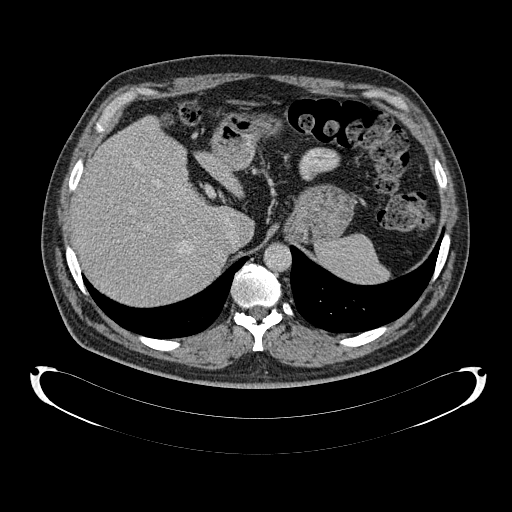

6_433
##########################################
Loaded 1092 image paths
##########################################
Printing Example Images



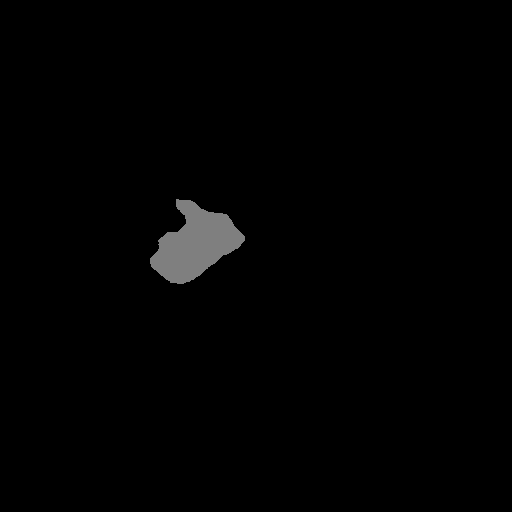

5_475
##########################################
Loaded 500 image paths
##########################################
Printing Example Images



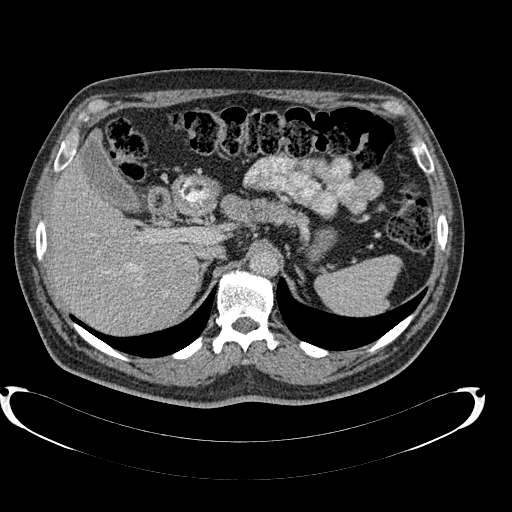

9_438
##########################################
Loaded 500 image paths
##########################################
Printing Example Images



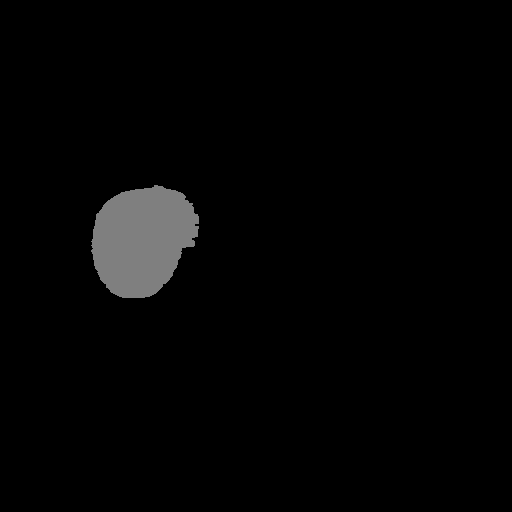

8_500
##########################################


In [6]:
# Loading the train images paths
train_images_paths = load_data(os.path.join(train_path, 'images'), print_imgs=1)

# Loading the train masks paths
train_masks_paths = load_data(os.path.join(train_path, 'masks'), print_imgs=1)

# Loading the validation images paths
val_images_paths = load_data(os.path.join(val_path, 'images'), print_imgs=1)

# Loading the validation masks paths
val_masks_paths = load_data(os.path.join(val_path, 'masks'), print_imgs=1)

## Load and Preprocess image using TF 2.0 [TODO]
These function loads images as tensors, and lay the groundwork for preprocessing

[TODO] add explanation of the functions

In [0]:
def preprocess_image(img_raw, norm=None, resize=None):
  # Decode png image into grayscale (channels = 1)
  img_tensor = tf.image.decode_png(img_raw, channels=1)
  if resize is not None:
    img_tensor = tf.image.resize(img_tensor, resize) # [192, 192]
  if norm is not None:
    img_tensor /= norm # 255.0
  return img_tensor
  
def load_and_preprocess_image(img_path, norm=None, resize=None):
  img_raw = tf.io.read_file(img_path)
  return preprocess_image(img_raw, norm=norm, resize=resize)

def load_and_preprocess_from_path_label(path, label, norm=None, resize=None):  
  return load_and_preprocess_image(path, norm=norm, resize=resize), load_and_preprocess_image(label, norm=norm, resize=resize)

## Creating Datasets using `tf.data.Dataset.from_tensor_slices`

In [0]:
def create_image_ds(image_paths, norm=None, resize=None):
  path_ds = tf.data.Dataset.from_tensor_slices(image_paths)
  image_ds = path_ds.map(lambda path: load_and_preprocess_image(path, norm=norm, resize=resize), num_parallel_calls=AUTOTUNE)
  return image_ds

def create_ds(image_paths, mask_paths, norm=None, resize=None):
  ds = tf.data.Dataset.from_tensor_slices((image_paths, mask_paths))
  label_ds = ds.map(
      lambda image_path, mask_path: load_and_preprocess_from_path_label(image_path, mask_path, norm=norm, resize=resize), 
      num_parallel_calls=AUTOTUNE
  )
  return label_ds

## Basic methods for training [TODO]
To train a model with this dataset you will want the data:

*   To be well shuffled.
*   To be batched.
*   To repeat forever.
*   Batches to be available as soon as possible.

These features can be easily added using the `tf.data` api.

In [0]:
def prepare_ds(ds, batch_size, buffer_size, shuffle=True):
  # Setting a shuffle buffer size as large as the dataset ensures that the data is
  # completely shuffled.
  if shuffle:
    ds = ds.shuffle(buffer_size=buffer_size)
  ds = ds.repeat()
  ds = ds.batch(batch_size=batch_size)
  
  # `prefetch` lets the dataset fetch batches, in the background while the model is training.
  ds = ds.prefetch(buffer_size=AUTOTUNE)
  return ds

# Define the model

## Model [TODO]



In [0]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Dropout, UpSampling2D, concatenate

def unet(pretrained_weights=None, shape=(256, 256, 1), filters=64):
    # First 3 layers
    inputs = Input(shape=shape, name='input')    
    conv1 = Conv2D(filters=filters, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv1_1')(inputs)   
    conv1 = Conv2D(filters=filters, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv1_2')(conv1)
    
    # Second 3 layers
    pool1 = MaxPooling2D(pool_size=2, name='pool2_0')(conv1)
    conv2 = Conv2D(filters=filters*2, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv2_1')(pool1)
    conv2 = Conv2D(filters=filters*2, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv2_2')(conv2)
    
    # Third 3 layers
    pool2 = MaxPooling2D(pool_size=2, name='pool3_0')(conv2)
    conv3 = Conv2D(filters=filters*4, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv3_1')(pool2)
    conv3 = Conv2D(filters=filters*4, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv3_2')(conv3)
    
    # Fourth 3 layers
    pool3 = MaxPooling2D(pool_size=2, name='pool4_0')(conv3)
    conv4 = Conv2D(filters=filters*8, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv4_1')(pool3)
    conv4 = Conv2D(filters=filters*8, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv4_2')(conv4)
    
    # Fifth Dropout layers
    drop4 = Dropout(rate=0.5, name='drop5_0')(conv4)
    
    # Fifth 3 layers
    pool4 = MaxPooling2D(pool_size=2, name='pool5_0')(drop4)
    conv5 = Conv2D(filters=filters*16, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv5_1')(pool4)
    conv5 = Conv2D(filters=filters*16, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv5_2')(conv5)
    
    # sixth Dropout layers
    drop5 = Dropout(rate=0.5, name='drop6_0')(conv5)
    
    # seventh concat layer
    up6 = Conv2D(filters=filters*8, kernel_size=2, activation='relu', padding='same', kernel_initializer='he_normal', name='conv7_concat')(
        UpSampling2D(size=2, name='up7_concat')(drop5)
    )
    merge6 = concatenate([drop4, up6], axis=3, name='concat7_0')
        
    # Rest of seventh layer
    conv6 = Conv2D(filters=filters*8, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv7_1')(merge6)
    conv6 = Conv2D(filters=filters*8, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv7_2')(conv6)

    # Eighth concat layer
    up7 = Conv2D(filters=filters*4, kernel_size=2, activation='relu', padding='same', kernel_initializer='he_normal', name='conv8_concat')(
        UpSampling2D(size=2, name='up8_concat')(conv6)
    )
    merge7 = concatenate([conv3,up7], axis=3, name='concat8_0')
    
    # Rest of eighth layer
    conv7 = Conv2D(filters=filters*4, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv8_1')(merge7)
    conv7 = Conv2D(filters=filters*4, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv8_2')(conv7)

    # Ninth concat layer
    up8 = Conv2D(filters=filters*2, kernel_size=2, activation='relu', padding='same', kernel_initializer='he_normal', name='conv9_concat')(
        UpSampling2D(size=2, name='up9_concat')(conv7)
    )
    merge8 = concatenate([conv2,up8], axis=3, name='concat9_0')
    
    # Rest of Ninth layer
    conv8 = Conv2D(filters=filters*2, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv9_1')(merge8)
    conv8 = Conv2D(filters=filters*2, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv9_2')(conv8)

    # Tenth concat layer
    up9 = Conv2D(filters=filters, kernel_size=2, activation='relu', padding='same', kernel_initializer='he_normal', name='conv10_concat')(
        UpSampling2D(size=2, name='up10_concat')(conv8)
    )
    merge9 = concatenate([conv1,up9], axis=3, name='concat10_0')
    
    # Rest of Tenth layer
    conv9 = Conv2D(filters=filters, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv10_1')(merge9)
    conv9 = Conv2D(filters=filters, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv10_2')(conv9)
    conv9 = Conv2D(filters=2, kernel_size=3, activation='relu', padding='same', kernel_initializer='he_normal', name='conv10_3')(conv9)
    
    conv10 = Conv2D(filters=1, kernel_size=1, activation='sigmoid', name='conv11_0')(conv9)
    
    model = Model(inputs, conv10, name="unet")
       
    if(pretrained_weights):
    	model.load_weights(pretrained_weights)

    return model  

## Define loss function and metrices

In [0]:
def quantizatize(img, q, scale, isfloat=True):
  q = 255 // q
  img_q = img*255 if isfloat else img
  img_q = (img_q // q) * q
  img_q = img_q / scale
  img_q = img_q if isfloat else img_q * 255
  return img_q

In [0]:
from tensorflow.keras import backend as K

def dice_coef(y_true, y_pred, smooth=1):
  """
  Dice = 2*TP/ (2TP + FP + FN)
       =  2*sum(|A*B|)/(sum(A^2)+sum(B^2))
  ref: https://arxiv.org/pdf/1606.04797v1.pdf
  """
  y_true_f = K.flatten(y_true)
  y_pred_f = K.flatten(y_pred)
  intersection = K.sum(K.abs(y_true_f * y_pred_f))
  return (2. * intersection + smooth) / (K.sum(K.square(y_true_f)) + K.sum(K.square(y_pred_f)) + smooth)

def dice_coef_loss(y_true, y_pred):
  return 1-dice_coef(y_true, y_pred) 

def replace_tensor(tensor, frm, to):
  return tf.where(tf.equal(frm, tensor), to*tf.ones_like(tensor), tensor)

def dice_coef_liver(y_true, y_pred, smooth=1):
  y_pred_liver = quantizatize(y_pred, 3, 170.0)
  y_pred_liver = replace_tensor(y_pred_liver, 1.0, 0.0)
  y_true_liver = replace_tensor(y_true, 1.0, 0.0)
  
  return dice_coef(y_true_liver, y_pred_liver, smooth=smooth)
    
def dice_coef_tumor(y_true, y_pred, smooth=1):
  y_pred_tumor = y_pred
#   y_pred_tumor = quantizatize_K(y_pred, 3, 170.0)
#   y_pred_tumor = replace_tensor(y_pred_tumor, 0.5, 0.0)
  y_true_tumor = replace_tensor(y_true, 0.5, 0.0)

  return dice_coef(y_true_tumor, y_pred_tumor, smooth=smooth)

def dice_coef_tumor_loss(y_true, y_pred, smooth=1):
  y_true_liver = replace_tensor(y_true, 1.0, 0.0)
  return 1-dice_coef(y_true_liver, y_pred, smooth=smooth)

def dice_coef_liver_loss(y_true, y_pred, smooth=1):
  return 1-dice_coef_liver(y_true, y_pred) 

## Prepare Tensorboard [collapse]

In [0]:
%%capture
!wget https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
!unzip ngrok-stable-linux-amd64.zip

# Load the TensorBoard notebook extension
%load_ext tensorboard.notebook

# Clear any logs from previous runs
!rm -rf ./logs/

LOG_DIR = 'logs/fit'
get_ipython().system_raw(
    'tensorboard --logdir {} --host 0.0.0.0 --port 6006 &'
    .format(LOG_DIR)
)

get_ipython().system_raw('./ngrok http 6006 &')

# Train Model

In [14]:
# For using tensorboard externally with ngrok
# ! curl -s http://localhost:4040/api/tunnels | python3 -c \
#     "import sys, json; print(json.load(sys.stdin)['tunnels'][0]['public_url'])"

# For using tensorboard locally in notebook
%tensorboard --logdir logs/fit
# %tensorboard --logdir LiverSegmentation/logs/fit

In [0]:
from prettytable import PrettyTable
t = PrettyTable(['Run', 'Optimizer', 'Batch Size', 'Resize', 'Filters', 'Learning Rate', 'Epochs'])

In [0]:
from tensorflow.keras.optimizers import Adam
# from tensorflow.keras.callbacks import ModelCheckpoint, LearningRateScheduler
import datetime
from tensorflow.keras.callbacks import TensorBoard
import time
from tensorflow.keras.metrics import Precision, Recall

#Parameters 

def model_fit(
    table,
    train_images_paths=train_images_paths,
    train_masks_paths=train_masks_paths,
    val_images_paths=val_images_paths,
    val_masks_paths=val_masks_paths,
    resize=[256, 256], # resize=[128, 128]
    norm=255.0,
    BATCH_SIZE=32,
    filters=4,
    lr=1e-3,
    epochs=30,
    loss=dice_coef_loss,
    metrics=[dice_coef, Precision(), Recall()],
    verbose=1, 
    pretrained_weights=None,
    train_ds=None,
    val_ds=None
):
  start_time = time.time()
  input_shape = (resize[0], resize[1], 1)
  optimizer = Adam(lr=lr)
  run_time = datetime.datetime.now().strftime("%m%d-%H%M%S")
  log_dir="logs/fit/" + run_time + 'lr' + str(lr) + 'f' + str(filters) + 's' + str(resize[0]) + 'e' + str(epochs) + 'b' + str(BATCH_SIZE)
  steps_per_epoch = int(len(train_images_paths)/BATCH_SIZE)
  validation_steps = int(len(val_images_paths)/BATCH_SIZE)

  # Print stat
  print('steps_per_epoch =', steps_per_epoch, 'validation_steps =', validation_steps)
  table.add_row([run_time, 'Adam', BATCH_SIZE, resize[0], filters, lr, epochs])
  print(table)


  # Create Datasets
  if train_ds is None:
    train_ds = create_ds(train_images_paths, train_masks_paths, norm=norm, resize=resize)
    train_ds = prepare_ds(train_ds, batch_size=BATCH_SIZE, buffer_size=len(train_images_paths))
    
  if val_ds is None:
    val_ds = create_ds(val_images_paths, val_masks_paths, norm=norm, resize=resize)
    val_ds = prepare_ds(val_ds, batch_size=BATCH_SIZE, buffer_size=len(val_images_paths))


  # Create Model
  model = unet(shape=input_shape, filters=filters, pretrained_weights=pretrained_weights)
  model.compile(optimizer=optimizer, loss=loss, metrics=metrics)

  if pretrained_weights is None:
    tensorboard_callback = TensorBoard(
        log_dir=log_dir,
        histogram_freq=1,
    #     batch_size=BATCH_SIZE,
    #     write_graph=True,
    #     write_grads=False,
    #     write_images=True
    #     embeddings_freq=0,
    #     embeddings_layer_names=None,
    #     embeddings_metadata=None,
    #     embeddings_data=None,
    #     update_freq='epoch'
    )

    callbacks=[ tensorboard_callback ]

    model.fit(
        train_ds,
    #     batch_size=BATCH_SIZE,
        epochs=epochs, #epochs=200,
        verbose=verbose,
        callbacks=callbacks,
    #     validation_split=0.0,
        validation_data=val_ds,
    #     shuffle=True,
    #     class_weight=None,
    #     sample_weight=None,
    #     initial_epoch=0,
        steps_per_epoch=steps_per_epoch,
        validation_steps=validation_steps,
    #     max_queue_size=10,
    #     workers=1,
    #     use_multiprocessing=False,
    #     **kwargs
    )
  print("--- %s seconds ---" % (time.time() - start_time))
  model.save_weights(run_time + 'lr' + str(lr) + 'f' + str(filters) + 's' + str(resize[0]) + 'e' + str(epochs) + '.h5')
  return model

In [0]:
import matplotlib.pyplot as plt
import numpy as np
from skimage import io

def predict_model(
    model,
    ds,
    steps,
    images_paths,
    masks_paths,
    verbose=1,
    images_to_print=10
):
  pred = model.predict(
      ds,
  #     batch_size=1,
      verbose=verbose,
      steps=steps,
  #           max_queue_size=10,
  #           workers=1,
  #           use_multiprocessing=False
  )
  print(pred.shape)
  
  plt.figure(figsize=(24, images_to_print*6))
  splt = 1
  for i in range(images_to_print):
    plt.subplot(images_to_print, 4, splt)
    plt.imshow(np.squeeze(pred[i,:,:,:]), cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
    plt.title('pred_' + image_name(images_paths[i]))
    plt.xticks([])
    plt.yticks([])
    plt.subplot(images_to_print, 4, splt+1)
    plt.imshow(quantizatize(np.squeeze(pred[i,:,:,:]), 3, 170.0), cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
    plt.title('quant_' + image_name(images_paths[i]))
    plt.xticks([])
    plt.yticks([])
    if masks_paths is not None:
      plt.subplot(images_to_print, 4, splt+2)
      plt.imshow(io.imread(masks_paths[i], as_gray=True), cmap='gray', vmin=0, vmax=1)
      plt.grid(False)
      plt.title('val_' + image_name(masks_paths[i]))
      plt.xticks([])
      plt.yticks([])    
    plt.subplot(images_to_print, 4, splt+3)
    plt.imshow(io.imread(images_paths[i], as_gray=True), cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
    plt.title('original_' + image_name(images_paths[i]))
    plt.xticks([])
    plt.yticks([])
    splt += 4
    
#   plt.show()
  return pred
    
    
def predict_model_tmp(
  model,
  val_images_paths=val_images_paths,
  val_masks_paths=val_masks_paths,
  norm=255.0,
  resize=[256, 256], # resize=[128, 128]
  verbose=1,
  images_to_print=10
):
  tmp_ds = create_ds(val_images_paths, val_masks_paths, norm=norm, resize=resize)
  tmp_ds = prepare_ds(tmp_ds, batch_size=1, buffer_size=len(val_images_paths), shuffle=False)
  print(tmp_ds)
  
  return predict_model(
      model=model,
      ds=tmp_ds, 
      steps=len(val_images_paths),
      images_paths=val_images_paths,
      masks_paths=val_masks_paths,
      verbose=verbose,
      images_to_print=images_to_print
  )

In [18]:
model_pre_trained = model_fit(
    table=t,
    resize=[256, 256], # resize=[128, 128]
    BATCH_SIZE=32,
    filters=4,
    lr=1e-3,
    epochs=50,
    loss=dice_coef_loss,
    metrics=[dice_coef, Precision(), Recall(), dice_coef_liver, dice_coef_tumor],
    train_images_paths=train_images_paths,
    train_masks_paths=train_masks_paths,
    val_images_paths=val_images_paths,
    val_masks_paths=val_masks_paths,
    pretrained_weights='/content/LiverSegmentation/logs/0601-130319lr0.001f4s256e30.h5'
)

steps_per_epoch = 34 validation_steps = 15
+-------------+-----------+------------+--------+---------+---------------+--------+
|     Run     | Optimizer | Batch Size | Resize | Filters | Learning Rate | Epochs |
+-------------+-----------+------------+--------+---------+---------------+--------+
| 0604-172900 |    Adam   |     32     |  256   |    4    |     0.001     |   50   |
+-------------+-----------+------------+--------+---------+---------------+--------+
--- 0.8750269412994385 seconds ---


In [19]:
val_amir_path = os.path.join(repo_path, 'data', 'val_amir')
# Loading the validation images paths
val_amir_images_paths = load_data(os.path.join(val_amir_path, 'images'), print_imgs=0)

# Loading the validation masks paths
val_amir_masks_paths = load_data(os.path.join(val_amir_path, 'masks'), print_imgs=0)

Loaded 230 image paths
Loaded 230 image paths


In [20]:
norm=255.0
resize=[256,256]
amir_ds = create_ds(val_amir_images_paths, val_amir_masks_paths, norm=norm, resize=resize)
amir_ds = prepare_ds(amir_ds, batch_size=1, buffer_size=len(val_amir_images_paths), shuffle=False)
model_pre_trained.evaluate(amir_ds, steps=len(val_amir_images_paths))

230/230 [==============================] - 5s 23ms/step - loss: 0.0304 - dice_coef: 0.9696 - precision_1: 0.9940 - recall_1: 0.5933 - dice_coef_liver: 0.9526 - dice_coef_tumor: 0.9696


[0.03043198585510254, 0.9695678, 0.9940199, 0.5932838, 0.9525767, 0.9695656]

<PrefetchDataset shapes: ((None, 256, 256, 1), (None, 256, 256, 1)), types: (tf.float32, tf.float32)>
230/230 [==============================] - 2s 9ms/step
(230, 256, 256, 1)


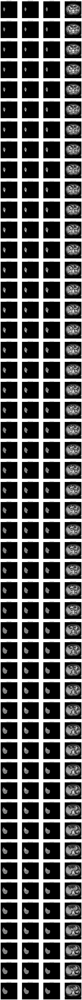

In [23]:
pred_pre = predict_model_tmp(model_pre_trained, images_to_print=50, val_images_paths=val_amir_images_paths, val_masks_paths=val_amir_masks_paths)

In [0]:
import matplotlib.pyplot as plt
import numpy as np
from skimage import io
from skimage.transform import resize

def print_model_scores(
    model,
    ds,
    steps,
    images_paths,
    pred=None,
    verbose=1,
    images_to_print=10,
    masks_paths=val_masks_paths
):  
  def dice_coef_tmp(y_true, y_pred, smooth=1):
    """
    Dice = 2*TP/ (2TP + FP + FN)
         =  2*sum(|A*B|)/(sum(A^2)+sum(B^2))
    ref: https://arxiv.org/pdf/1606.04797v1.pdf
    """
    y_true_f = y_true.flatten()
    y_pred_f = y_pred.flatten()
    intersection = np.sum(np.abs(y_true_f * y_pred_f))
    return (2. * intersection + smooth) / (np.sum(np.square(y_true_f)) + np.sum(np.square(y_pred_f)) + smooth)

  if pred is None:
    pred = model.predict(
        ds,
        #     batch_size=1,
        verbose=verbose,
        steps=steps,
        #           max_queue_size=10,
        #           workers=1,
        #           use_multiprocessing=False
    )
    print(pred.shape)
    
  splt = 1
  num_of_splt = 6
  plt.figure(figsize=(num_of_splt*6, images_to_print*6))
  for i in range(images_to_print):
    y_pred = quantizatize(np.squeeze(pred[i,:,:,:]), 3, 170)
    y_true = io.imread(masks_paths[i], as_gray=True)
    y_true = resize(y_true, (256, 256))
    y_true = quantizatize(np.squeeze(y_true), 2, 254)

    y_pred_liver = y_pred.copy()
    y_pred_liver[y_pred_liver==1] = 0
    y_true_liver = y_true.copy()
    y_true_liver[y_true_liver==1] = 0

    y_pred_tumor = y_pred.copy()
    y_pred_tumor[y_pred_tumor==0.5] = 0
    y_true_tumor = y_true.copy()
    y_true_tumor[y_true_tumor==0.5] = 0
    
    plt.subplot(images_to_print, num_of_splt, splt)
    plt.imshow(y_pred, cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
    plt.title('y_pred ' + str(dice_coef_tmp(y_true_liver, y_pred_liver)))
    plt.xticks([])
    plt.yticks([])

    plt.subplot(images_to_print, num_of_splt, splt+1)
    plt.imshow(y_true, cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
    plt.title('y_true')
    plt.xticks([])
    plt.yticks([])
  
    plt.subplot(images_to_print, num_of_splt, splt+2)
    plt.imshow(y_pred_liver, cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
    plt.title('y_pred_liver ' + str(dice_coef_tmp(y_true_liver, y_pred_liver)))
    plt.xticks([])
    plt.yticks([])

    plt.subplot(images_to_print, num_of_splt, splt+3)
    plt.imshow(y_true_liver, cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
    plt.title('y_true_liver')
    plt.xticks([])
    plt.yticks([])

    plt.subplot(images_to_print, num_of_splt, splt+4)
    plt.imshow(y_pred_tumor, cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
    plt.title('y_pred_tumor ' + str(dice_coef_tmp(y_true_tumor, y_pred_tumor)))
    plt.xticks([])
    plt.yticks([])  

    plt.subplot(images_to_print, num_of_splt, splt+5)
    plt.imshow(y_true_tumor, cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
    plt.title('y_true_tumor')
    plt.xticks([])
    plt.yticks([])  
    splt += num_of_splt
    
  plt.show()
  return pred
    
    
def print_model_scores_tmp(
  model,
  pred=None,
  val_images_paths=val_images_paths,
  val_masks_paths=val_masks_paths,
  norm=255.0,
  _resize=[256, 256], # resize=[128, 128]
  verbose=1,
  images_to_print=10,
):
  tmp_ds = create_ds(val_images_paths, val_masks_paths, norm=norm, resize=_resize)
  tmp_ds = prepare_ds(tmp_ds, batch_size=1, buffer_size=len(val_images_paths), shuffle=False)
  print(tmp_ds)
  
  return print_model_scores(
      model=model,
      pred=pred,
      ds=tmp_ds, 
      steps=len(val_images_paths),
      images_paths=val_images_paths,
      masks_paths=val_masks_paths,
      verbose=verbose,
      images_to_print=images_to_print,
  )

<PrefetchDataset shapes: ((None, 256, 256, 1), (None, 256, 256, 1)), types: (tf.float32, tf.float32)>


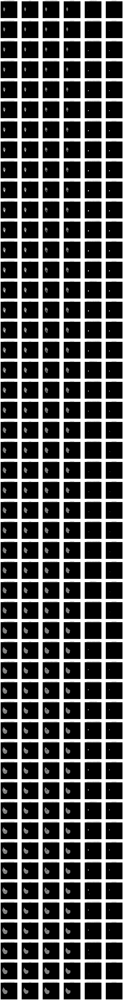

array([[[[5.08219481e-01],
         [2.84174085e-02],
         [4.53406572e-03],
         ...,
         [3.29968333e-03],
         [7.15041161e-03],
         [1.08465850e-02]],

        [[6.15529120e-02],
         [1.32530928e-04],
         [1.66594982e-05],
         ...,
         [6.44326210e-05],
         [1.31940842e-03],
         [1.43306851e-02]],

        [[1.18506551e-02],
         [5.84125519e-06],
         [1.49011612e-07],
         ...,
         [1.70767307e-05],
         [6.92635775e-04],
         [8.27020407e-03]],

        ...,

        [[5.86980581e-03],
         [2.50339508e-06],
         [1.19209290e-07],
         ...,
         [1.31875277e-04],
         [1.35004520e-05],
         [1.70618296e-04]],

        [[1.28213167e-02],
         [3.12924385e-05],
         [5.69224358e-06],
         ...,
         [7.32660294e-04],
         [5.44428825e-04],
         [3.18288803e-05]],

        [[8.82646441e-03],
         [1.85957551e-03],
         [1.43274665e-03],
         ...,
 

In [26]:
print_model_scores_tmp(None, val_images_paths=val_amir_images_paths, val_masks_paths=val_amir_masks_paths, pred=pred_pre, images_to_print=50)

In [0]:
model = model_dice_coef_tumor_loss

In [18]:
model_dice_coef_tumor_loss = model_fit(
    table=t,
    resize=[256, 256], # resize=[128, 128]
    BATCH_SIZE=32,
    filters=4,
    lr=1e-3,
    epochs=50,
    loss=dice_coef_loss
    metrics=[dice_coef, Precision(), Recall(), dice_coef_liver, dice_coef_tumor],
    train_images_paths=train_images_paths[55:],
    train_masks_paths=train_masks_paths[55:],
    val_images_paths=val_images_paths,
    val_masks_paths=val_masks_paths,
#     pretrained_weights='/content/LiverSegmentation/logs/0601-130319lr0.001f4s256e30.h5'
)

SyntaxError: ignored

<PrefetchDataset shapes: ((None, 256, 256, 1), (None, 256, 256, 1)), types: (tf.float32, tf.float32)>
500/500 [==============================] - 5s 9ms/step
(500, 256, 256, 1)


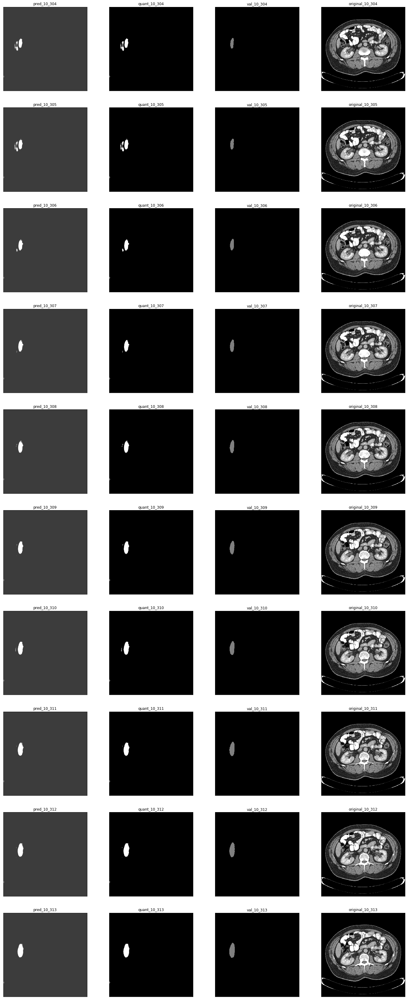

In [68]:
predict_model_tmp(model_dice_coef_tumor_loss, images_to_print=10);

In [18]:
norm=255.0
resize=[255, 255]
train_ds = create_ds(train_images_paths, train_masks_paths, norm=norm, resize=resize)
# train_ds = prepare_ds(train_ds, batch_size=BATCH_SIZE, buffer_size=len(train_images_paths))

val_ds = create_ds(val_images_paths, val_masks_paths, norm=norm, resize=resize)
# val_ds = prepare_ds(val_ds, batch_size=BATCH_SIZE, buffer_size=len(val_images_paths))


def print_images_paths(images_paths):
  for i in range(11):
    print(i, sum(1 if image_name(image_path).startswith(str(i) + '_') else 0 for image_path in images_paths))
    
# print('train_images_paths')
# print_images_paths(train_images_paths)
# print()
# print('val_images_paths')
# print_images_paths(val_images_paths)
print_images_paths(train_images_paths[55:])
print()

0 0
1 0
2 130
3 164
4 240
5 162
6 174
7 167
8 0
9 0
10 0



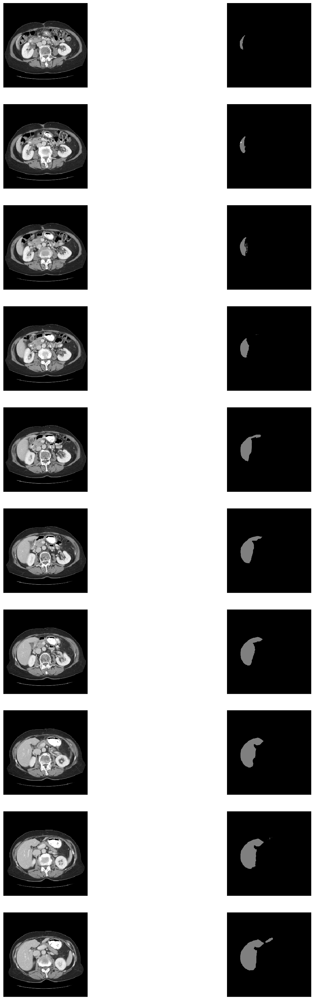

In [28]:
import numpy as np
import matplotlib.pyplot as plt
import math
import skimage as io

def plot_images(dataset, n_images):
  plt.figure(figsize=(24, n_images*12))
  splt = 1
  for image, mask in dataset.take(n_images):
    plt.subplot(n_images*2, 2, splt)
    plt.imshow(np.squeeze(image.numpy()), cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
#     plt.title('image_' + image_name(images_paths[i]))
    plt.xticks([])
    plt.yticks([])
    
    plt.subplot(n_images*2, 2, splt+1)
    plt.imshow(np.squeeze(mask.numpy()), cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
#     plt.title('mask_' + image_name(images_paths[i]))
    plt.xticks([])
    plt.yticks([])  
    splt += 2          
  plt.show()

def flip(x, seed=None):
  """Flip augmentation

  Args:
      x: Image to flip

  Returns:
      Augmented image
  """
  x = tf.image.random_flip_left_right(x, seed=seed)
  x = tf.image.random_flip_up_down(x, seed=seed)

  return x
  
def color(x, max_delta=0.05, seed=None):
  """Color augmentation

  Args:
      x: Image

  Returns:
      Augmented image
  """
#   x = tf.image.random_hue(x, 0.08, seed=seed)
#   x = tf.image.random_saturation(x, 0.6, 1.6, seed=seed)
  x = tf.image.random_brightness(x, max_delta=max_delta, seed=seed)
#   x = tf.image.random_contrast(x, 0.7, 1.3, seed=seed)
  return x
  
def rotate(x, seed=None):
  """Rotation augmentation

  Args:
      x: Image

  Returns:
      Augmented image
  """
#   print(x.dtype)

  return tf.image.rot90(x, tf.random.uniform(shape=[], minval=1, maxval=4, dtype=tf.int32, seed=seed))
#   return tf.py_function(lambda image: io.transform.rotate(image, tf.random.uniform(shape=[], minval=-45, maxval=45, dtype=tf.int32, seed=seed), clip=True
#                 resize=True, mode='constant'
#                ), [x], Tout=tf.float32)

def zoom(x, seed=None):
  """Zoom augmentation

  Args:
      x: Image

  Returns:
      Augmented image
  """

  # Generate 20 crop settings, ranging from a 1% to 20% crop.
  scales = list(np.arange(0.8, 1.0, 0.01))
  boxes = np.zeros((len(scales), 4))

  for i, scale in enumerate(scales):
      x1 = y1 = 0.5 - (0.5 * scale)
      x2 = y2 = 0.5 + (0.5 * scale)
      boxes[i] = [x1, y1, x2, y2]

  def random_crop(img, seed=None):
      # Create different crops for an image
      crops = tf.image.crop_and_resize([img], boxes=boxes, box_indices=np.zeros(len(scales)), crop_size=(32, 32))
      # Return a random crop
      return crops[tf.random.uniform(shape=[], minval=0, maxval=len(scales), dtype=tf.int32, seed=seed)]


  choice = tf.random.uniform(shape=[], minval=0., maxval=1., dtype=tf.float32, seed=seed)

  # Only apply cropping 50% of the time
  return tf.cond(choice < 0.5, lambda: x, lambda: random_crop(x, seed=seed))

def apply_da(ds, f):
  return ds.map(lambda x,y: (tf.clip_by_value(f(x), 0, 1), tf.clip_by_value(f(y), 0, 1)), num_parallel_calls=4)

seed = 42
max_delta = 0.1


train_ds_original = create_ds(train_images_paths, train_masks_paths, norm=norm, resize=resize)
train_ds_rotate = apply_da(create_ds(train_images_paths, train_masks_paths, norm=norm, resize=resize), lambda x: rotate(x, seed=seed))
train_ds_color = apply_da(create_ds(train_images_paths, train_masks_paths, norm=norm, resize=resize), lambda x: color(x, max_delta=max_delta, seed=seed))

# train_ds_rotateio = apply_da(
#     create_ds(train_images_paths, train_masks_paths, norm=norm, resize=resize),
#     lambda image: io.transform.rotate(image, 
# #                                       tf.random.uniform(shape=[], minval=-45, maxval=45, dtype=tf.int32, seed=seed),
#                                       angle=45,
#                                       clip=True
# #                 resize=True, mode='constant'
#                                      ),
# )
# plot_images(train_ds_rotateio, n_images=10)

train_ds = train_ds_original.concatenate(train_ds_rotate).concatenate(train_ds_color)
plot_images(train_ds, n_images=10)

In [0]:
model_dice_coef_loss = model

In [37]:
model_dice_coef_tumor_loss = model_fit(
    table=t,
    resize=[256, 256], # resize=[128, 128]
    BATCH_SIZE=32,
    filters=4,
    lr=1e-4,
    epochs=30,
    loss=dice_coef_tumor_loss,
    metrics=[dice_coef, Precision(), Recall(), dice_coef_liver, dice_coef_tumor],
    train_images_paths=train_images_paths[55:],
    train_masks_paths=train_masks_paths[55:],
    val_images_paths=val_images_paths,
    val_masks_paths=val_masks_paths,
#     pretrained_weights='/content/LiverSegmentation/logs/0601-130319lr0.001f4s256e30.h5'
)

steps_per_epoch = 32 validation_steps = 15
+-------------+-----------+------------+--------+---------+---------------+--------+
|     Run     | Optimizer | Batch Size | Resize | Filters | Learning Rate | Epochs |
+-------------+-----------+------------+--------+---------+---------------+--------+
| 0604-151229 |    Adam   |     32     |  256   |    4    |     0.0001    |   30   |
| 0604-152335 |    Adam   |     32     |  256   |    4    |     0.0001    |   30   |
| 0604-153054 |    Adam   |     32     |  256   |    4    |     0.0001    |   30   |
+-------------+-----------+------------+--------+---------+---------------+--------+
Epoch 1/30


ValueError: ignored

<PrefetchDataset shapes: ((None, 256, 256, 1), (None, 256, 256, 1)), types: (tf.float32, tf.float32)>
500/500 [==============================] - 4s 9ms/step
(500, 256, 256, 1)


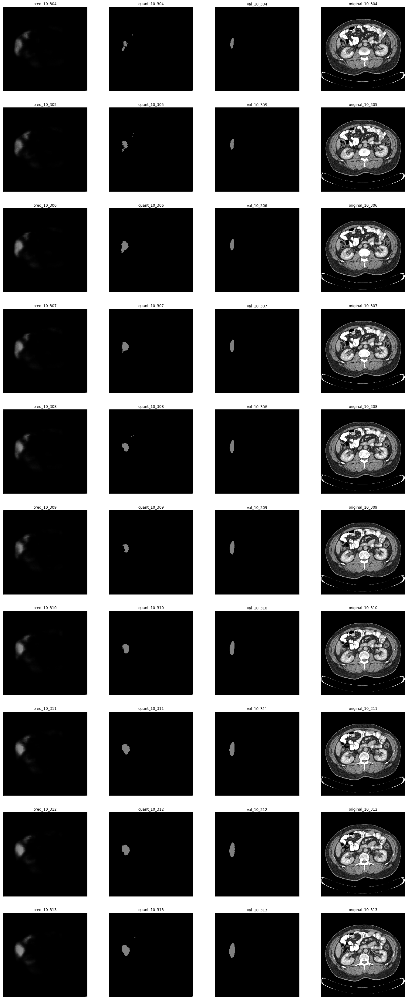

array([[[[0.40249887],
         [0.3338149 ],
         [0.00925145],
         ...,
         [0.00354761],
         [0.13259262],
         [0.07695875]],

        [[0.38822347],
         [0.17775023],
         [0.15773684],
         ...,
         [0.00215691],
         [0.05866271],
         [0.08908445]],

        [[0.31097758],
         [0.0082159 ],
         [0.00733212],
         ...,
         [0.00144038],
         [0.0714258 ],
         [0.08046779]],

        ...,

        [[0.09880498],
         [0.00597468],
         [0.00276509],
         ...,
         [0.00072417],
         [0.0233323 ],
         [0.25832134]],

        [[0.03410345],
         [0.00889307],
         [0.00426659],
         ...,
         [0.05568194],
         [0.17361552],
         [0.23042881]],

        [[0.0354161 ],
         [0.02115205],
         [0.01144749],
         ...,
         [0.49380818],
         [0.49380818],
         [0.49380818]]],


       [[[0.40465534],
         [0.33687165],
         [0.00

In [33]:
predict_model_tmp(model, images_to_print=10);

In [0]:
%cd LiverSegmentation
!jupyter nbconvert --to latex "LiverSegmentationReport.ipynb"
%cd ..

In [16]:
model = model_fit(
    table=t,
    resize=[256, 256], # resize=[128, 128]
    BATCH_SIZE=32,
    filters=4,
    lr=1e-3,
    epochs=30,
    pretrained_weights='/content/LiverSegmentation/logs/0601-130319lr0.001f4s256e30.h5'
)

steps_per_epoch = 34 validation_steps = 15
+-------------+-----------+------------+--------+---------+---------------+--------+
|     Run     | Optimizer | Batch Size | Resize | Filters | Learning Rate | Epochs |
+-------------+-----------+------------+--------+---------+---------------+--------+
| 0602-155426 |    Adam   |     32     |  256   |    4    |     0.001     |   30   |
+-------------+-----------+------------+--------+---------+---------------+--------+
--- 0.6357998847961426 seconds ---


In [27]:
model = model_fit(
    table=t,
    resize=[256, 256], # resize=[128, 128]
    BATCH_SIZE=32,
    filters=4,
    lr=1e-3,
    epochs=30,
    metrics=[dice_coef, Precision(), Recall(), dice_coef_liver, dice_coef_tumor],
    pretrained_weights='/content/LiverSegmentation/logs/0601-130319lr0.001f4s256e30.h5'
)

steps_per_epoch = 34 validation_steps = 15
+-------------+-----------+------------+--------+---------+---------------+--------+
|     Run     | Optimizer | Batch Size | Resize | Filters | Learning Rate | Epochs |
+-------------+-----------+------------+--------+---------+---------------+--------+
| 0602-151324 |    Adam   |     32     |  256   |    4    |     0.001     |   30   |
| 0602-153715 |    Adam   |     32     |  256   |    4    |     0.001     |   30   |
| 0602-153752 |    Adam   |     32     |  256   |    4    |     0.001     |   30   |
+-------------+-----------+------------+--------+---------+---------------+--------+
--- 0.8726253509521484 seconds ---


## Print model information [collapse]

Model: "unet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input (InputLayer)              [(None, 256, 256, 1) 0                                            
__________________________________________________________________________________________________
conv1_1 (Conv2D)                (None, 256, 256, 4)  40          input[0][0]                      
__________________________________________________________________________________________________
conv1_2 (Conv2D)                (None, 256, 256, 4)  148         conv1_1[0][0]                    
__________________________________________________________________________________________________
pool2_0 (MaxPooling2D)          (None, 128, 128, 4)  0           conv1_2[0][0]                    
_______________________________________________________________________________________________

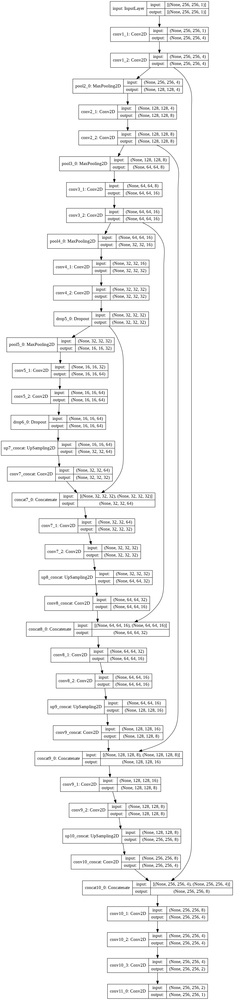

In [17]:
import matplotlib.pyplot as plt
from tensorflow.keras.utils import plot_model

model.summary()
plot_model(model, 'Siamese Network Architecture.png', show_shapes=True)
display.display(display.Image('Siamese Network Architecture.png'))

# Results

In [30]:
tmp_ds = create_ds(val_images_paths, val_masks_paths, norm=255.0, resize=[256, 256])
tmp_ds = prepare_ds(tmp_ds, batch_size=1, buffer_size=len(val_images_paths), shuffle=False)
print(tmp_ds)

model.evaluate(
    tmp_ds,
    verbose=1,
    steps=len(val_images_paths)
)

<PrefetchDataset shapes: ((None, 256, 256, 1), (None, 256, 256, 1)), types: (tf.float32, tf.float32)>
500/500 [==============================] - 6s 12ms/step - loss: 0.0366 - dice_coef: 0.9634 - precision_2: 0.9953 - recall_2: 0.5793 - dice_coef_liver: 0.9450 - dice_coef_tumor: 0.0539


[0.036627528309822084, 0.9633727, 0.99530053, 0.579268, 0.9450212, 0.053859778]

In [0]:
import matplotlib.pyplot as plt
import numpy as np
from skimage import io

def predict_model(
    model,
    ds,
    steps,
    images_paths,
    masks_paths,
    verbose=1,
    images_to_print=10
):
  pred = model.predict(
      ds,
  #     batch_size=1,
      verbose=verbose,
      steps=steps,
  #           max_queue_size=10,
  #           workers=1,
  #           use_multiprocessing=False
  )
  print(pred.shape)
  
  plt.figure(figsize=(24, images_to_print*6))
  splt = 1
  for i in range(images_to_print):
    plt.subplot(images_to_print, 4, splt)
    plt.imshow(np.squeeze(pred[i,:,:,:]), cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
    plt.title('pred_' + image_name(images_paths[i]))
    plt.xticks([])
    plt.yticks([])
    plt.subplot(images_to_print, 4, splt+1)
    plt.imshow(quantizatize(np.squeeze(pred[i,:,:,:]), 3, 170.0), cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
    plt.title('quant_' + image_name(images_paths[i]))
    plt.xticks([])
    plt.yticks([])
    if masks_paths is not None:
      plt.subplot(images_to_print, 4, splt+2)
      plt.imshow(io.imread(masks_paths[i], as_gray=True), cmap='gray', vmin=0, vmax=1)
      plt.grid(False)
      plt.title('val_' + image_name(masks_paths[i]))
      plt.xticks([])
      plt.yticks([])    
    plt.subplot(images_to_print, 4, splt+3)
    plt.imshow(io.imread(images_paths[i], as_gray=True), cmap='gray', vmin=0, vmax=1)
    plt.grid(False)
    plt.title('original_' + image_name(images_paths[i]))
    plt.xticks([])
    plt.yticks([])
    splt += 4
    
  plt.show()
  return pred
    
    
def predict_model_tmp(
  model,
  val_images_paths=val_images_paths,
  val_masks_paths=val_masks_paths,
  norm=255.0,
  resize=[256, 256], # resize=[128, 128]
  verbose=1,
  images_to_print=10
):
  tmp_ds = create_ds(val_images_paths, val_masks_paths, norm=norm, resize=resize)
  tmp_ds = prepare_ds(tmp_ds, batch_size=1, buffer_size=len(val_images_paths), shuffle=False)
  print(tmp_ds)
  
  return predict_model(
      model=model,
      ds=tmp_ds, 
      steps=len(val_images_paths),
      images_paths=val_images_paths,
      masks_paths=val_masks_paths,
      verbose=verbose,
      images_to_print=images_to_print
  )

<PrefetchDataset shapes: ((None, 256, 256, 1), (None, 256, 256, 1)), types: (tf.float32, tf.float32)>
500/500 [==============================] - 5s 9ms/step
(500, 256, 256, 1)


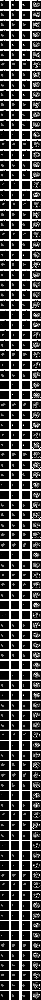

In [31]:
predict_model_tmp(model, images_to_print=100)

In [20]:
import matplotlib.pyplot as plt
import numpy as np
from skimage import io

tmp_ds = create_ds(val_images_paths, val_masks_paths, norm=255.0, resize=[256, 256])
tmp_ds = prepare_ds(tmp_ds, batch_size=1, buffer_size=len(val_images_paths), shuffle=False)
print(tmp_ds)

pred = model.predict(
    tmp_ds,
#     batch_size=1,
    verbose=1,
    steps=len(val_images_paths),
#           max_queue_size=10,
#           workers=1,
#           use_multiprocessing=False
)
print(pred.shape)

<PrefetchDataset shapes: ((None, 256, 256, 1), (None, 256, 256, 1)), types: (tf.float32, tf.float32)>
500/500 [==============================] - 5s 9ms/step
(500, 256, 256, 1)


In [39]:
from skimage.transform import resize

y_pred = quantizatize(np.squeeze(pred[0,:,:,:]), 3, 170)
y_true = io.imread(val_masks_paths[0], as_gray=True)
y_true = resize(y_true, (256, 256), anti_aliasing=True)
y_true = quantizatize(np.squeeze(y_true), 2, 254)
np.unique(y_true)

NameError: ignored

In [22]:
print(y_pred.shape, y_true.shape)
print(len(y_pred.flatten()), len(y_true.flatten()))

(256, 256) (256, 256)
65536 65536


<Figure size 2304x4320 with 0 Axes>

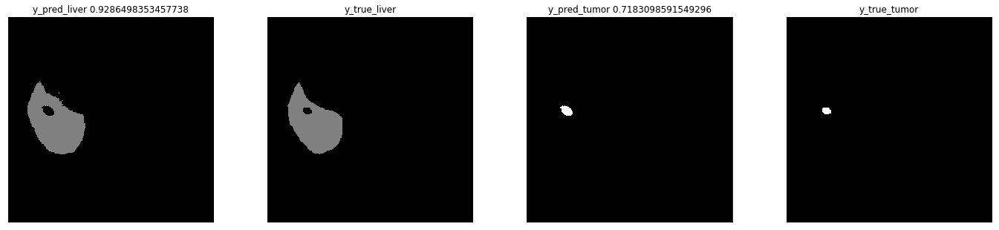

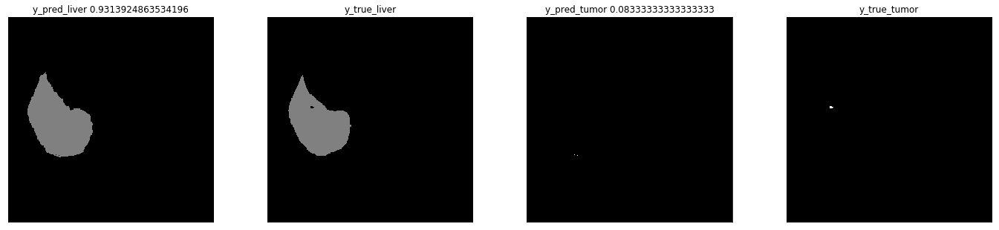

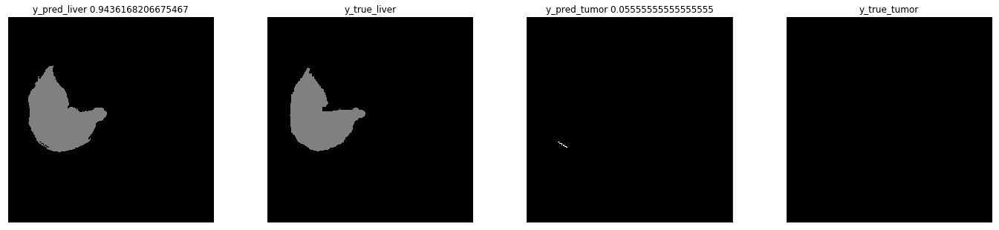

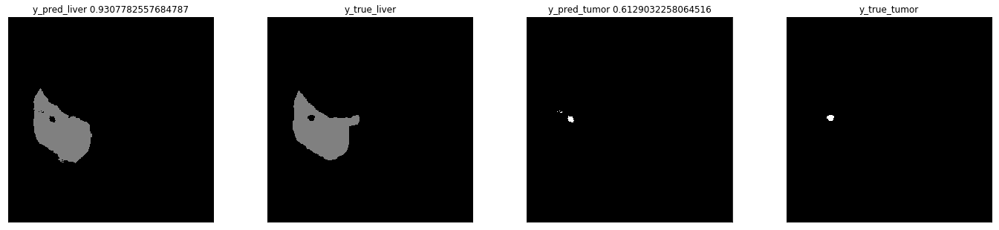

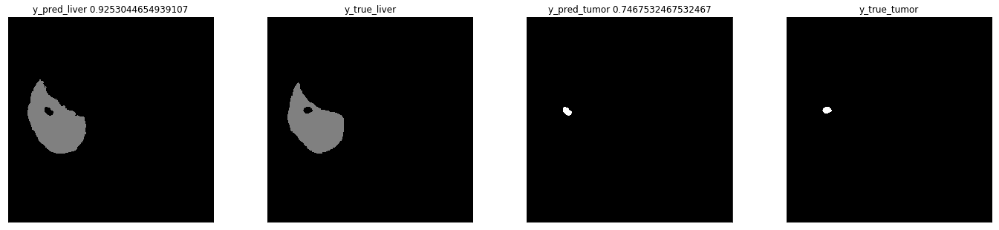

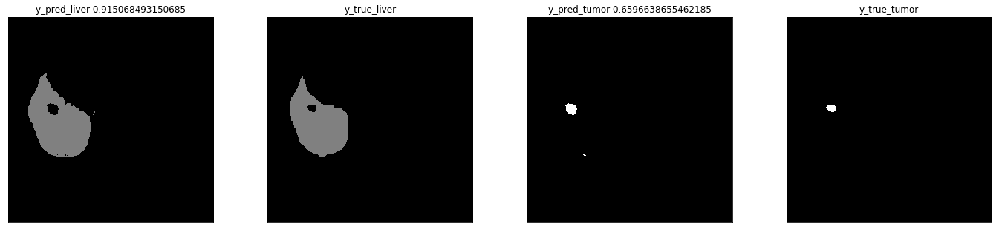

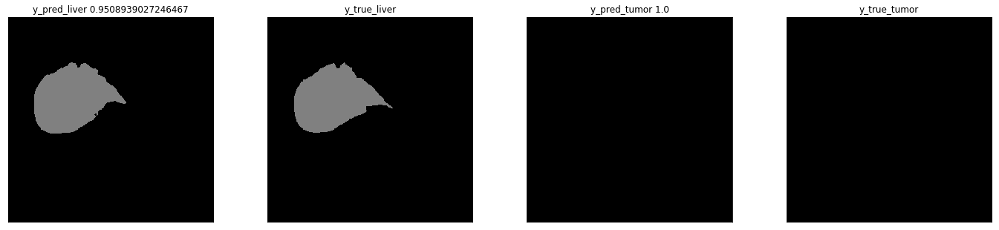

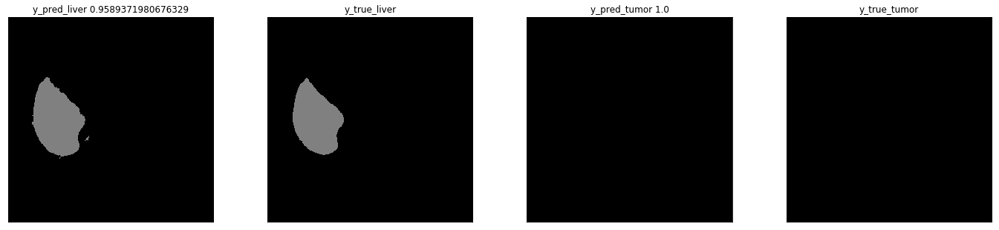

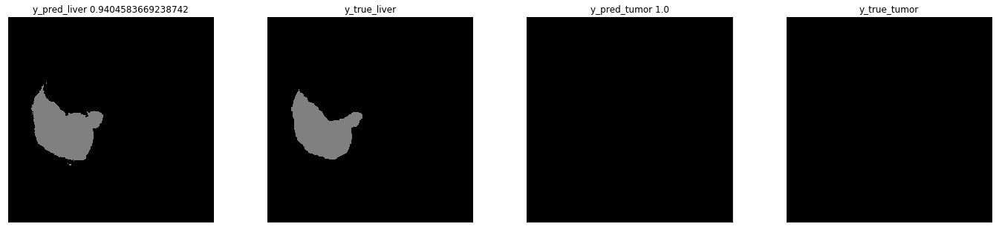

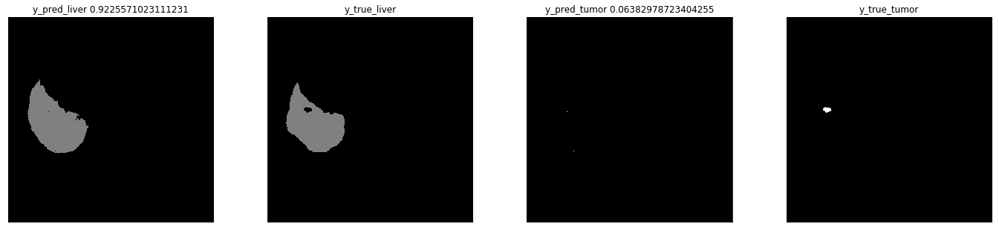

In [23]:
import matplotlib.pyplot as plt
import numpy as np
from skimage import io


def dice_coef_tmp(y_true, y_pred, smooth=1):
  """
  Dice = 2*TP/ (2TP + FP + FN)
       =  2*sum(|A*B|)/(sum(A^2)+sum(B^2))
  ref: https://arxiv.org/pdf/1606.04797v1.pdf
  """
  y_true_f = y_true.flatten()
  y_pred_f = y_pred.flatten()
  intersection = np.sum(np.abs(y_true_f * y_pred_f))
  return (2. * intersection + smooth) / (np.sum(np.square(y_true_f)) + np.sum(np.square(y_pred_f)) + smooth)


images_to_print=10

plt.figure(figsize=(32, images_to_print*6))
splt = 1
num_of_splt = 4
for i in range(images_to_print):
  y_pred = quantizatize(np.squeeze(pred[i,:,:,:]), 3, 170)
  y_true = io.imread(val_masks_paths[i], as_gray=True)
  y_true = resize(y_true, (256, 256))
  y_true = quantizatize(np.squeeze(y_true), 2, 254)
  
  y_pred_liver = y_pred.copy()
  y_pred_liver[y_pred_liver==1] = 0
  y_true_liver = y_true.copy()
  y_true_liver[y_true_liver==1] = 0
  
  y_pred_tumor = y_pred.copy()
  y_pred_tumor[y_pred_tumor==0.5] = 0
  y_true_tumor = y_true.copy()
  y_true_tumor[y_true_tumor==0.5] = 0

  plt.figure(figsize=(24, images_to_print*6))

#   plt.subplot(images_to_print, num_of_splt, splt)
#   plt.imshow(y_pred, cmap='gray', vmin=0, vmax=1)
#   plt.grid(False)
#   plt.title('y_pred')
#   plt.xticks([])
#   plt.yticks([])

#   plt.subplot(images_to_print, num_of_splt, splt+1)
#   plt.imshow(y_true, cmap='gray', vmin=0, vmax=1)
#   plt.grid(False)
#   plt.title('y_true')
#   plt.xticks([])
#   plt.yticks([])
  
  plt.subplot(images_to_print, num_of_splt, splt)
  plt.imshow(y_pred_liver, cmap='gray', vmin=0, vmax=1)
  plt.grid(False)
  plt.title('y_pred_liver ' + str(dice_coef_tmp(y_true_liver, y_pred_liver)))
  plt.xticks([])
  plt.yticks([])
  
  plt.subplot(images_to_print, num_of_splt, splt+1)
  plt.imshow(y_true_liver, cmap='gray', vmin=0, vmax=1)
  plt.grid(False)
  plt.title('y_true_liver')
  plt.xticks([])
  plt.yticks([])
  
  plt.subplot(images_to_print, num_of_splt, splt+2)
  plt.imshow(y_pred_tumor, cmap='gray', vmin=0, vmax=1)
  plt.grid(False)
  plt.title('y_pred_tumor ' + str(dice_coef_tmp(y_true_tumor, y_pred_tumor)))
  plt.xticks([])
  plt.yticks([])  
  
  plt.subplot(images_to_print, num_of_splt, splt+3)
  plt.imshow(y_true_tumor, cmap='gray', vmin=0, vmax=1)
  plt.grid(False)
  plt.title('y_true_tumor')
  plt.xticks([])
  plt.yticks([])  
  splt += num_of_splt

In [0]:
model.save_weights(run_time + 'lr' + str(lr) + 'f' + str(filters) + 's' + str(resize[0]) + 'e' + str(epochs) + '.h5')

In [31]:
!zip -r /content/logs.zip /content/logs

  adding: content/logs/ (stored 0%)
  adding: content/logs/fit/ (stored 0%)
  adding: content/logs/fit/0604-151229lr0.0001f4s256e30b32/ (stored 0%)
  adding: content/logs/fit/0604-151229lr0.0001f4s256e30b32/plugins/ (stored 0%)
  adding: content/logs/fit/0604-151229lr0.0001f4s256e30b32/plugins/profile/ (stored 0%)
  adding: content/logs/fit/0604-151229lr0.0001f4s256e30b32/plugins/profile/2019-06-04_15-12-45/ (stored 0%)
  adding: content/logs/fit/0604-151229lr0.0001f4s256e30b32/plugins/profile/2019-06-04_15-12-45/local.trace (deflated 87%)
  adding: content/logs/fit/0604-151229lr0.0001f4s256e30b32/train/ (stored 0%)
  adding: content/logs/fit/0604-151229lr0.0001f4s256e30b32/train/events.out.tfevents.1559661150.f9ba01d6a589.136.4547.v2 (deflated 84%)
  adding: content/logs/fit/0604-151229lr0.0001f4s256e30b32/validation/ (stored 0%)
  adding: content/logs/fit/0604-151229lr0.0001f4s256e30b32/validation/events.out.tfevents.1559661150.f9ba01d6a589.136.4555.v2 (deflated 69%)
